# Cool Title Here

Our study is about...

## Import Libraries

In [1]:
import pandas as pd
import numpy as np
import json
import os
import matplotlib.pyplot as plt
import seaborn as sns
from lime.lime_tabular import LimeTabularExplainer

from sklearn.preprocessing import StandardScaler

## Load Data

### load weather data

In [2]:
# Define the path to the directory containing weather data files
weather_data_path = 'weather'

# Initialize an empty list to store individual dataframes
weather_dfs = []

# Loop through all the files in the directory
for file_name in os.listdir(weather_data_path):
    if file_name.endswith('.csv'):  # Ensure we're only loading CSV files
        file_path = os.path.join(weather_data_path, file_name)
        df = pd.read_csv(file_path)
        weather_dfs.append(df)

# Concatenate all the individual dataframes into one dataframe
weather_data = pd.concat(weather_dfs, ignore_index=True)

# Convert the 'datetime' column to datetime format and set it as the index
weather_data['datetime'] = pd.to_datetime(weather_data['datetime'])
weather_data.set_index('datetime', inplace=True)

# Extract year and quarter from the datetime index
weather_data['Year'] = weather_data.index.year
weather_data['Quarter'] = weather_data.index.quarter

# Ensure Year and Quarter columns are of integer type
weather_data['Year'] = weather_data['Year'].astype(int)
weather_data['Quarter'] = weather_data['Quarter'].astype(int)

# Display the first few rows of the combined weather data
weather_data.head()

,name,tempmax,tempmin,temp,feelslikemax,feelslikemin,feelslike,dew,humidity,precip,...,severerisk,sunrise,sunset,moonphase,conditions,description,icon,stations,Year,Quarter
datetime,,,,,,,,,,,,,,,,,,,,,
1993-01-01,Aurora,30.1,20.8,25.5,32.0,20.8,26.2,20.5,75.9,0.0,...,NaN,1993-01-01T06:20:44,1993-01-01T17:32:39,0.25,Clear,Clear conditions throughout the day.,clear-day,"98336099999,98333099999",1993,1
1993-01-02,Aurora,26.4,20.5,23.7,26.4,20.5,23.7,21.3,86.9,0.0,...,NaN,1993-01-02T06:21:05,1993-01-02T17:33:14,0.29,Partially cloudy,Partly cloudy throughout the day.,partly-cloudy-day,"98336099999,98333099999",1993,1
1993-01-03,Aurora,29.4,21.7,25.5,34.1,21.7,27.0,22.0,81.7,0.0,...,NaN,1993-01-03T06:21:26,1993-01-03T17:33:49,0.33,Partially cloudy,Partly cloudy throughout the day.,partly-cloudy-day,"98336099999,98333099999",1993,1
1993-01-04,Aurora,27.9,20.6,24.4,31.3,20.6,25.0,21.9,86.5,1.0,...,NaN,1993-01-04T06:21:45,1993-01-04T17:34:25,0.36,"Rain, Partially cloudy",Partly cloudy throughout the day with rain in ...,rain,"98336099999,98333099999",1993,1
1993-01-05,Aurora,27.8,20.8,23.8,30.8,20.8,24.6,21.1,85.4,7.0,...,NaN,1993-01-05T06:22:04,1993-01-05T17:35:00,0.39,"Rain, Partially cloudy",Partly cloudy throughout the day with rain.,rain,"98336099999,98333099999",1993,1


### Load Crop Production Data

In [3]:
crop_data = pd.read_csv("crop.csv", sep=';', engine='python')
crop_data = crop_data.dropna(how='all', axis=0).dropna(how='all', axis=1)

In [4]:
df_crop_vertical = pd.DataFrame()
rows = []

for index, value in crop_data.iterrows():
    for v in value.items():
        row = {
            'Crop': value['Ecosystem/Croptype'],
            'Geolocation': value['Geolocation']
        }
        if 'Quarter' in v[0]:
            col = v[0].split(" ")
            row['Year'] = col[0]
            row['Quarter'] = int(col[2])
            row['Production'] = v[1]
        if 'Year' in row.keys():
            rows.append(row)
df_crop_vertical = pd.DataFrame(rows)
df_crop_vertical['Year'] = df_crop_vertical['Year'].astype(int)
df_crop_vertical

# Filter crop data to include only specified crops
filtered_crops = ['Irrigated Palay', 'Rainfed Palay', 'Palay']
df_crop_vertical = df_crop_vertical[df_crop_vertical['Crop'].isin(filtered_crops)]

# Remove "PHILIPPINES" from geolocation names
df_crop_vertical = df_crop_vertical[~df_crop_vertical['Geolocation'].str.contains('PHILIPPINES')]
df_crop_vertical

,Crop,Geolocation,Year,Quarter,Production
148,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,1,8299.00
149,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,2,54856.00
150,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,3,14236.00
151,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,4,67436.00
152,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1988,1,25393.00
...,...,...,...,...,...
7543,Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2022,4,188159.00
7544,Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,1,265574.15
7545,Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,2,133970.98
7546,Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,3,297324.61


In [5]:
df_crop_vertical['Crop'].unique()

array(['Irrigated Palay', 'Rainfed Palay', 'Palay'], dtype=object)

# EDA

## Summary Statistics

In [6]:
print(weather_data.describe())

             tempmax        tempmin           temp   feelslikemax  \
count  907794.000000  907794.000000  864139.000000  907794.000000   
mean       29.144399      22.697683      26.897434      34.990995   
std         6.980188       5.644142       2.092200       9.275569   
min         0.000000      -9.900000      -0.100000      -4.300000   
25%        28.900000      22.700000      26.000000      33.200000   
50%        30.900000      24.200000      27.200000      37.100000   
75%        32.100000      25.200000      28.200000      40.000000   
max        65.000000      38.200000      38.200000     127.900000   

        feelslikemin      feelslike            dew       humidity  \
count  907794.000000  864139.000000  861592.000000  864121.000000   
mean       22.891603      29.494993      23.402709      82.039476   
std         5.885180       3.647534       1.972910       6.499359   
min       -13.300000      -5.400000      -9.600000      11.000000   
25%        22.700000      27.3000

In [7]:
print(df_crop_vertical.describe())

             Year      Quarter    Production
count  7104.00000  7104.000000  7.104000e+03
mean   2005.00000     2.500000  1.504119e+05
std      10.67783     1.118113  2.002689e+05
min    1987.00000     1.000000  0.000000e+00
25%    1996.00000     1.750000  3.194117e+04
50%    2005.00000     2.500000  8.754600e+04
75%    2014.00000     3.250000  1.748688e+05
max    2023.00000     4.000000  1.707242e+06


## Check Missing Values

In [8]:
# Check Missing Values
print(weather_data.isnull().sum())
print(df_crop_vertical.isnull().sum())

name                     0
tempmax              16659
tempmin              16659
temp                 60314
feelslikemax         16659
feelslikemin         16659
feelslike            60314
dew                  62861
humidity             60332
precip              106535
precipprob           60314
precipcover              0
preciptype          349735
snow                650835
snowdepth           650384
windgust            640338
windspeed            43655
winddir              63785
sealevelpressure     89559
cloudcover           60341
visibility          122990
solarradiation      502929
solarenergy         502929
uvindex             502929
severerisk          858681
sunrise                  0
sunset                   0
moonphase                0
conditions           60314
description          60314
icon                 60314
stations             60314
Year                     0
Quarter                  0
dtype: int64
Crop           0
Geolocation    0
Year           0
Quarter        0
P

In [9]:
# Check data types before merging
print("Weather Data Types:")
print(weather_data.dtypes)
print("Crop Data Types:")
print(df_crop_vertical.dtypes)

Weather Data Types:
name                 object
tempmax             float64
tempmin             float64
temp                float64
feelslikemax        float64
feelslikemin        float64
feelslike           float64
dew                 float64
humidity            float64
precip              float64
precipprob          float64
precipcover         float64
preciptype           object
snow                float64
snowdepth           float64
windgust            float64
windspeed           float64
winddir             float64
sealevelpressure    float64
cloudcover          float64
visibility          float64
solarradiation      float64
solarenergy         float64
uvindex             float64
severerisk          float64
sunrise              object
sunset               object
moonphase           float64
conditions           object
description          object
icon                 object
stations             object
Year                  int64
Quarter               int64
dtype: object
Crop Data Type

## Temperature trends

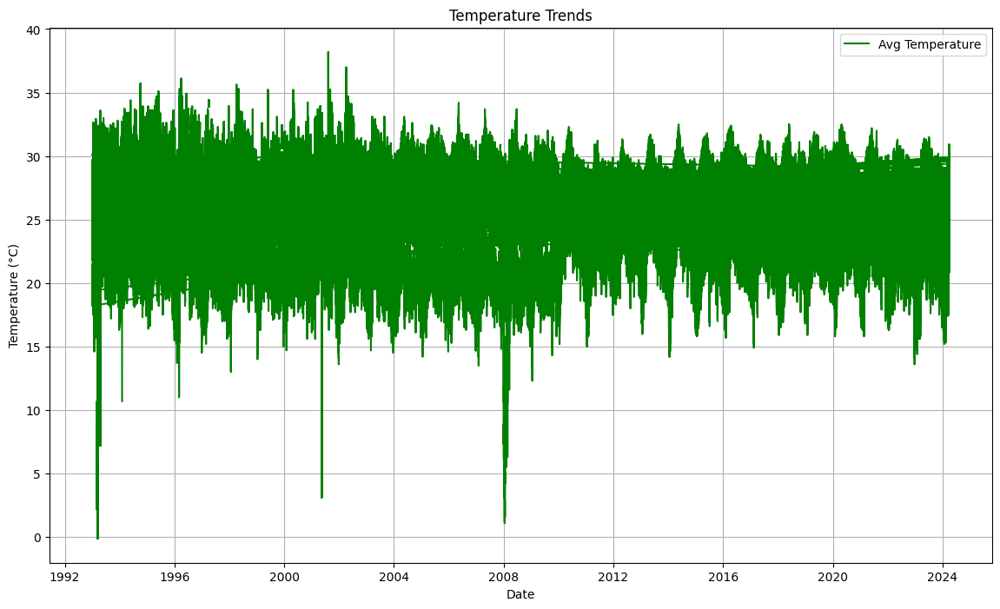

In [10]:
# Temperature Trends
plt.figure(figsize=(14, 8))
# plt.plot(weather_data.index, weather_data['tempmax'], label='Max Temperature', color='red')
# plt.plot(weather_data.index, weather_data['tempmin'], label='Min Temperature', color='blue')
plt.plot(weather_data.index, weather_data['temp'], label='Avg Temperature', color='green')
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.title('Temperature Trends')
plt.legend()
plt.grid(True)
plt.show()

## Crop Trends

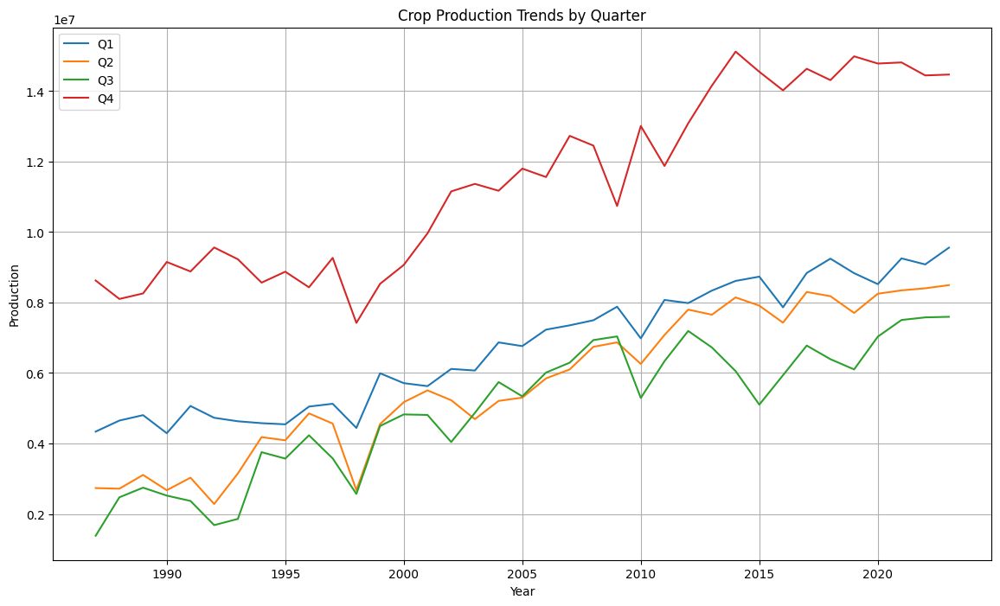

In [11]:
crop_trends = df_crop_vertical.groupby(['Year','Quarter'])['Production'].sum().reset_index()
plt.figure(figsize=(14, 8))
for quarter in range(1, 5):
    quarterly_data = crop_trends[crop_trends['Quarter'] == quarter]
    plt.plot(quarterly_data['Year'], quarterly_data['Production'], label=f'Q{quarter}')
plt.xlabel('Year')
plt.ylabel('Production')
plt.title('Crop Production Trends by Quarter')
plt.legend()
plt.grid(True)
plt.show()

### Group by Crop Type and calculate mean production

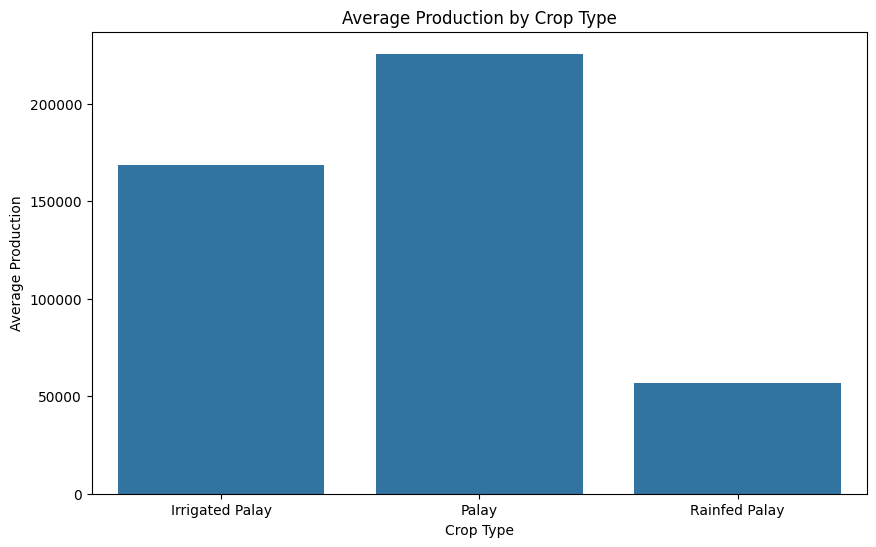

In [12]:
crop_grouped = df_crop_vertical.groupby('Crop')['Production'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(x='Crop', y='Production', data=crop_grouped)
plt.title('Average Production by Crop Type')
plt.xlabel('Crop Type')
plt.ylabel('Average Production')
plt.show()

## Geolocation Analysis for Filtered Crops

/var/folders/kd/gsh4dwkd2l7btm02qq5d4qxw0000gn/T/ipykernel_1517/2561240911.py:8: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  production_by_geo['Total Production'] = production_by_geo.sum(axis=1)


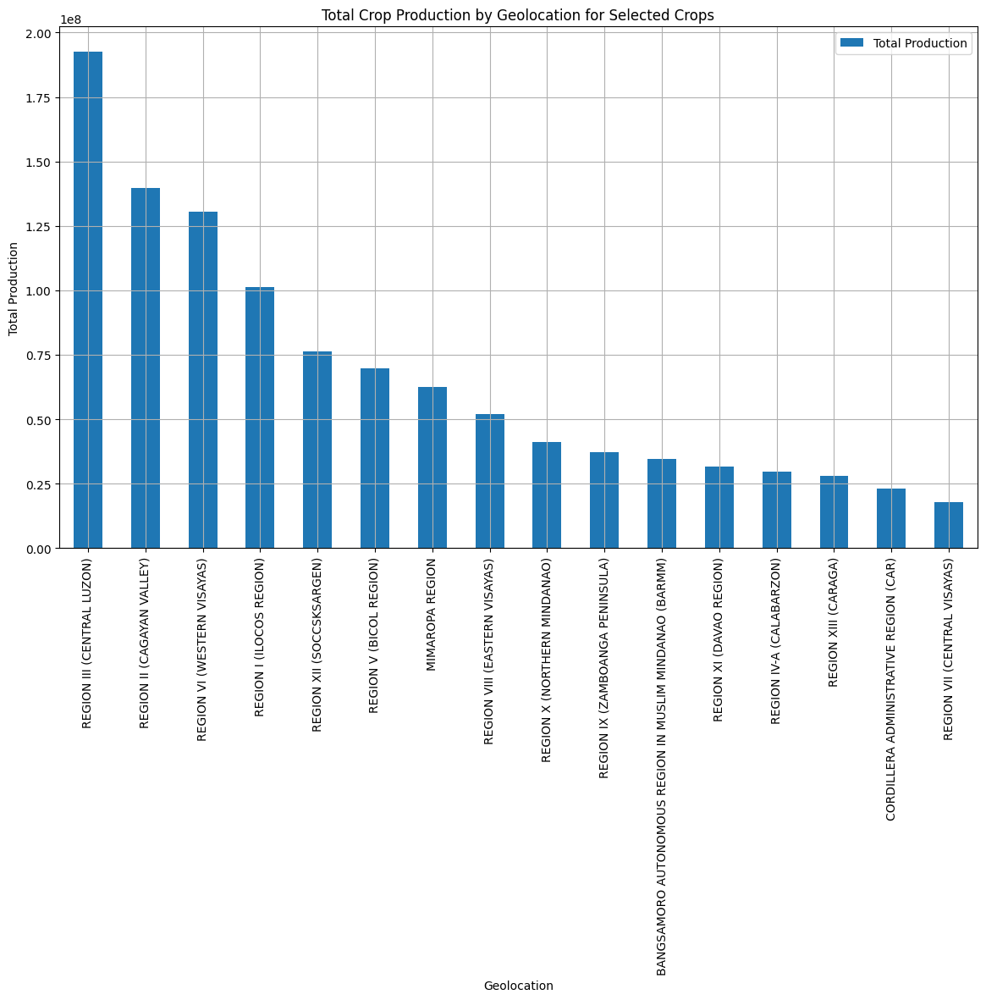

In [13]:
# Group by geolocation and crop, sum production, and unstack
production_by_geo = df_crop_vertical.groupby(['Geolocation', 'Crop'])['Production'].sum().unstack().fillna(0)

# Reset the index to get the 'Production' column back
production_by_geo = production_by_geo.reset_index()

# Create a new column for 'Total Production'
production_by_geo['Total Production'] = production_by_geo.sum(axis=1)

# Sort geolocations in ascending order
production_by_geo = production_by_geo.sort_values(by='Geolocation')

# Sort geolocations by total production in descending order
production_by_geo = production_by_geo.sort_values(by='Total Production', ascending=False)

# Plot the data
production_by_geo.plot(kind='bar', x='Geolocation', y='Total Production', figsize=(14, 8), stacked=True)

# Add labels and title
plt.xlabel('Geolocation')
plt.ylabel('Total Production')
plt.title('Total Crop Production by Geolocation for Selected Crops')

# Rotate x-axis labels
plt.xticks(rotation=90)

# Add grid
plt.grid(True)

# Display the plot
plt.show()

# Data Preprocessing

## Crop Data

Preprocessing for Crop Data

In [14]:
df_crop = pd.read_csv("crop.csv", sep=';', engine='python')
df_crop = df_crop.dropna(how='all', axis=0).dropna(how='all', axis=1)

### Flatten the data to make it vertical

In [15]:
df_crop_vertical = pd.DataFrame()
rows = []

for index, value in df_crop.iterrows():
    for v in value.items():
        row = {
            'Crop': value['Ecosystem/Croptype'],
            'Geolocation': value['Geolocation']
        }
        if 'Quarter' in v[0]:
            col = v[0].split(" ")
            row['Year'] = col[0]
            row['Quarter'] = int(col[2])
            row['Production'] = v[1]
        if 'Year' in row.keys():
            rows.append(row)
df_crop_vertical = pd.DataFrame(rows)

# Filter crop data to include only specified crops
filtered_crops = ['Irrigated Palay', 'Rainfed Palay']#, 'Palay']
df_crop_vertical = df_crop_vertical[df_crop_vertical['Crop'].isin(filtered_crops)]

# Remove "PHILIPPINES" from geolocation names
df_crop_vertical = df_crop_vertical[~df_crop_vertical['Geolocation'].str.contains('PHILIPPINES')]
df_crop_vertical

,Crop,Geolocation,Year,Quarter,Production
148,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,1,8299.00
149,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,2,54856.00
150,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,3,14236.00
151,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1987,4,67436.00
152,Irrigated Palay,CORDILLERA ADMINISTRATIVE REGION (CAR),1988,1,25393.00
...,...,...,...,...,...
5027,Rainfed Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2022,4,145270.50
5028,Rainfed Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,1,181164.53
5029,Rainfed Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,2,74129.41
5030,Rainfed Palay,BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANA...,2023,3,215256.17


In [16]:
region_to_island = {
    'CORDILLERA ADMINISTRATIVE REGION (CAR)': 'Luzon',
    'REGION I (ILOCOS REGION)': 'Luzon',
    'REGION II (CAGAYAN VALLEY)': 'Luzon',
    'REGION III (CENTRAL LUZON)': 'Luzon',
    'REGION IV-A (CALABARZON)': 'Luzon',
    'MIMAROPA REGION': 'Luzon',
    'REGION V (BICOL REGION)': 'Luzon',
    'REGION VI (WESTERN VISAYAS)': 'Visayas',
    'REGION VII (CENTRAL VISAYAS)': 'Visayas',
    'REGION VIII (EASTERN VISAYAS)': 'Visayas',
    'REGION IX (ZAMBOANGA PENINSULA)': 'Mindanao',
    'REGION X (NORTHERN MINDANAO)': 'Mindanao',
    'REGION XI (DAVAO REGION)': 'Mindanao',
    'REGION XII (SOCCSKSARGEN)': 'Mindanao',
    'REGION XIII (CARAGA)': 'Mindanao',
    'BANGSAMORO AUTONOMOUS REGION IN MUSLIM MINDANAO (BARMM)': 'Mindanao'
}

df_crop_vertical['Geolocation'] = df_crop_vertical['Geolocation'].map(region_to_island)
df_crop_vertical.head(3)

,Crop,Geolocation,Year,Quarter,Production
148,Irrigated Palay,Luzon,1987,1,8299.0
149,Irrigated Palay,Luzon,1987,2,54856.0
150,Irrigated Palay,Luzon,1987,3,14236.0


## Weather Data

Preprocessing for weather data

In [17]:
df_weather = pd.DataFrame()

# List all files in the weather directory
files = os.listdir('weather')

for file in files:
    # Construct the full file path
    file_path = os.path.join('weather', file)
    
    # Check if it's a file and not a directory
    if os.path.isfile(file_path) and '.DS' not in file:
        # Read the CSV file and concatenate it to the DataFrame
        df_weather = pd.concat([df_weather, pd.read_csv(file_path)])

print(df_weather)

                    name    datetime  tempmax  tempmin  temp  feelslikemax  \
0                 Aurora  1993-01-01     30.1     20.8  25.5          32.0   
1                 Aurora  1993-01-02     26.4     20.5  23.7          26.4   
2                 Aurora  1993-01-03     29.4     21.7  25.5          34.1   
3                 Aurora  1993-01-04     27.9     20.6  24.4          31.3   
4                 Aurora  1993-01-05     27.8     20.8  23.8          30.8   
...                  ...         ...      ...      ...   ...           ...   
45647  Compostela Valley  2024-03-27     34.1     25.0  28.9          41.2   
45648  Compostela Valley  2024-03-28     33.0     26.0  27.6          39.1   
45649  Compostela Valley  2024-03-29     30.0     25.0  26.8          36.1   
45650  Compostela Valley  2024-03-30     34.0     24.0  28.3          39.2   
45651  Compostela Valley  2024-03-31     33.0     26.0  28.8          39.1   

       feelslikemin  feelslike   dew  humidity  ...  solarenerg

### Remove irrelevant columns

Like snow. And the other columns have too many NaNs. And the correlated features.

In [18]:
df_weather.columns

Index(['name', 'datetime', 'tempmax', 'tempmin', 'temp', 'feelslikemax',
       'feelslikemin', 'feelslike', 'dew', 'humidity', 'precip', 'precipprob',
       'precipcover', 'preciptype', 'snow', 'snowdepth', 'windgust',
       'windspeed', 'winddir', 'sealevelpressure', 'cloudcover', 'visibility',
       'solarradiation', 'solarenergy', 'uvindex', 'severerisk', 'sunrise',
       'sunset', 'moonphase', 'conditions', 'description', 'icon', 'stations'],
      dtype='object')

In [19]:
exclude_cols = ['snow', 'snowdepth', 'solarradiation', 'solarenergy',
                'uvindex', 'severerisk', 'windgust', 'feelslikemax', 'feelslikemin', 'feelslike']
df_weather = df_weather.loc[:, ~df_weather.columns.isin(exclude_cols)]

In [20]:
df_weather.columns

Index(['name', 'datetime', 'tempmax', 'tempmin', 'temp', 'dew', 'humidity',
       'precip', 'precipprob', 'precipcover', 'preciptype', 'windspeed',
       'winddir', 'sealevelpressure', 'cloudcover', 'visibility', 'sunrise',
       'sunset', 'moonphase', 'conditions', 'description', 'icon', 'stations'],
      dtype='object')

### Get numeric columns only

In [21]:
df_weather.set_index(['name', 'datetime'], inplace=True)
df_weather = df_weather.select_dtypes(include=np.number)

### Impute NaN using column mean

In [22]:
df_weather = df_weather.apply(lambda x: x.fillna(x.mean()))
df_weather.reset_index(inplace=True)
df_weather.set_index('name', inplace=True)

### Map to Island

In [23]:
province_to_region = {
    'Abra': 'Luzon',
    'Agusan del Norte': 'Mindanao',
    'Agusan del Sur': 'Mindanao',
    'Aklan': 'Visayas',
    'Albay': 'Luzon',
    'Antique': 'Visayas',
    'Apayao': 'Luzon',
    'Aurora': 'Luzon',
    'Basilan': 'Mindanao',
    'Bataan': 'Luzon',
    'Batanes': 'Luzon',
    'Batangas': 'Luzon',
    'Benguet': 'Luzon',
    'Biliran': 'Visayas',
    'Bohol': 'Visayas',
    'Bukidnon': 'Mindanao',
    'Bulacan': 'Luzon',
    'Cagayan': 'Luzon',
    'Camarines Norte': 'Luzon',
    'Camarines Sur': 'Luzon',
    'Camiguin': 'Mindanao',
    'Capiz': 'Visayas',
    'Catanduanes': 'Luzon',
    'Cavite': 'Luzon',
    'Cebu': 'Visayas',
    'Compostela Valley': 'Mindanao',
    'Davao Oriental': 'Mindanao',
    'Davao del Norte': 'Mindanao',
    'Davao del Sur': 'Mindanao',
    'Dinagat Islands': 'Mindanao',
    'Eastern Samar': 'Visayas',
    'Guimaras': 'Visayas',
    'Ifugao': 'Luzon',
    'Ilocos Norte': 'Luzon',
    'Ilocos Sur': 'Luzon',
    'Iloilo': 'Visayas',
    'Isabela': 'Luzon',
    'Kalinga': 'Luzon',
    'La Union': 'Luzon',
    'Laguna': 'Luzon',
    'Lanao del Norte': 'Mindanao',
    'Lanao del Sur': 'Mindanao',
    'Leyte': 'Visayas',
    'Maguindanao': 'Mindanao',
    'Marinduque': 'Luzon',
    'Masbate': 'Luzon',
    'Metropolitan Manila': 'Luzon',
    'Misamis Occidental': 'Mindanao',
    'Misamis Oriental': 'Mindanao',
    'Mountain Province': 'Luzon',
    'Negros Occidental': 'Visayas',
    'Negros Oriental': 'Visayas',
    'North Cotabato': 'Mindanao',
    'Northern Samar': 'Visayas',
    'Nueva Ecija': 'Luzon',
    'Nueva Vizcaya': 'Luzon',
    'Occidental Mindoro': 'Luzon',
    'Oriental Mindoro': 'Luzon',
    'Palawan': 'Luzon',
    'Pampanga': 'Luzon',
    'Pangasinan': 'Luzon',
    'Quezon': 'Luzon',
    'Quirino': 'Luzon',
    'Rizal': 'Luzon',
    'Romblon': 'Luzon',
    'Samar': 'Visayas',
    'Sarangani': 'Mindanao',
    'Siquijor': 'Visayas',
    'Sorsogon': 'Luzon',
    'South Cotabato': 'Mindanao',
    'Southern Leyte': 'Visayas',
    'Sultan Kudarat': 'Mindanao',
    'Sulu': 'Mindanao',
    'Surigao del Norte': 'Mindanao',
    'Surigao del Sur': 'Mindanao',
    'Tarlac': 'Luzon',
    'Tawi-Tawi': 'Mindanao',
    'Zambales': 'Luzon',
    'Zamboanga Sibugay': 'Mindanao',
    'Zamboanga del Norte': 'Mindanao',
    'Zamboanga del Sur': 'Mindanao'
}
df_weather.reset_index(inplace=True)
df_weather['region'] = df_weather['name'].map(province_to_region)
df_weather.drop('name', inplace=True, axis=1)
df_weather


,datetime,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase,region
0,1993-01-01,30.1,20.8,25.5,20.5,75.9,0.0,0.0,0.00,9.5,124.3,1017.8,17.8,28.1,0.25,Luzon
1,1993-01-02,26.4,20.5,23.7,21.3,86.9,0.0,0.0,0.00,10.8,138.3,1017.5,62.1,28.8,0.29,Luzon
2,1993-01-03,29.4,21.7,25.5,22.0,81.7,0.0,0.0,0.00,13.6,77.9,1017.0,53.2,27.5,0.33,Luzon
3,1993-01-04,27.9,20.6,24.4,21.9,86.5,1.0,100.0,4.17,14.9,352.3,1017.6,57.7,26.6,0.36,Luzon
4,1993-01-05,27.8,20.8,23.8,21.1,85.4,7.0,100.0,8.33,10.0,19.7,1018.5,69.6,23.6,0.39,Luzon
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
924448,2024-03-27,34.1,25.0,28.9,24.2,77.2,0.4,100.0,4.17,18.4,32.4,1012.9,66.5,10.5,0.56,Mindanao
924449,2024-03-28,33.0,26.0,27.6,25.5,89.7,2.8,100.0,33.33,18.4,34.4,1012.5,71.2,9.8,0.60,Mindanao
924450,2024-03-29,30.0,25.0,26.8,25.0,91.2,7.7,100.0,37.50,22.3,29.3,1013.1,88.3,9.5,0.63,Mindanao
924451,2024-03-30,34.0,24.0,28.3,23.6,77.6,0.2,100.0,8.33,18.4,40.4,1013.4,49.1,10.0,0.67,Mindanao


### Aggregate data on a quarterly basis

In [24]:
df_weather['datetime'] = pd.to_datetime(df_weather['datetime'])
df_weather['year'] = df_weather['datetime'].dt.year
df_weather['quarter'] = df_weather['datetime'].dt.quarter
df_weather.drop('datetime', inplace=True, axis=1)
df_weather.reset_index(inplace=True)

df_weather_aggregated = df_weather.groupby(['region', 'year', 'quarter']).mean()
df_weather_aggregated.drop(['index'], axis=1, inplace=True)
df_weather_aggregated.reset_index(inplace=True)
df_weather_aggregated

,region,year,quarter,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase
0,Luzon,1993,1,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667
1,Luzon,1993,2,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352
2,Luzon,1993,3,28.913673,22.711307,26.979919,23.873858,83.763352,9.810591,67.325800,5.197096,15.879650,187.879503,1008.458675,76.066747,15.815292,0.490326
3,Luzon,1993,4,27.658281,21.876887,26.033209,22.929041,83.576384,11.155602,64.380950,5.586224,17.848964,116.088297,1010.215606,73.388174,15.291133,0.474457
4,Luzon,1994,1,27.932426,21.326636,25.855922,21.970333,79.926055,3.985291,43.002640,2.927641,17.136666,112.817994,1012.096323,62.183844,16.455047,0.470000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
370,Visayas,2023,1,29.030278,23.208611,25.519167,22.340000,83.371528,8.046648,90.277778,18.993243,20.714861,62.811111,1010.835278,75.402847,18.035069,0.481889
371,Visayas,2023,2,31.478022,24.491690,27.437431,23.384959,79.394712,5.953988,90.521978,20.086724,15.808379,144.123146,1009.385920,71.172665,19.228984,0.461868
372,Visayas,2023,3,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891
373,Visayas,2023,4,30.801902,24.278668,27.003668,23.695041,82.763451,6.895497,94.089674,18.124586,16.838927,85.877717,1010.938519,63.951495,19.031182,0.503152


### Join weather data and crop data

Use region, year, and quarter

In [25]:
df_crop_vertical['Year'] = df_crop_vertical['Year'].astype(int)

In [26]:
df_crop_vertical["Year"] = pd.to_numeric(df_crop_vertical["Year"] )

In [27]:
df_crop_vertical

,Crop,Geolocation,Year,Quarter,Production
148,Irrigated Palay,Luzon,1987,1,8299.00
149,Irrigated Palay,Luzon,1987,2,54856.00
150,Irrigated Palay,Luzon,1987,3,14236.00
151,Irrigated Palay,Luzon,1987,4,67436.00
152,Irrigated Palay,Luzon,1988,1,25393.00
...,...,...,...,...,...
5027,Rainfed Palay,Mindanao,2022,4,145270.50
5028,Rainfed Palay,Mindanao,2023,1,181164.53
5029,Rainfed Palay,Mindanao,2023,2,74129.41
5030,Rainfed Palay,Mindanao,2023,3,215256.17


In [28]:
df_weather_aggregated

,region,year,quarter,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase
0,Luzon,1993,1,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667
1,Luzon,1993,2,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352
2,Luzon,1993,3,28.913673,22.711307,26.979919,23.873858,83.763352,9.810591,67.325800,5.197096,15.879650,187.879503,1008.458675,76.066747,15.815292,0.490326
3,Luzon,1993,4,27.658281,21.876887,26.033209,22.929041,83.576384,11.155602,64.380950,5.586224,17.848964,116.088297,1010.215606,73.388174,15.291133,0.474457
4,Luzon,1994,1,27.932426,21.326636,25.855922,21.970333,79.926055,3.985291,43.002640,2.927641,17.136666,112.817994,1012.096323,62.183844,16.455047,0.470000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
370,Visayas,2023,1,29.030278,23.208611,25.519167,22.340000,83.371528,8.046648,90.277778,18.993243,20.714861,62.811111,1010.835278,75.402847,18.035069,0.481889
371,Visayas,2023,2,31.478022,24.491690,27.437431,23.384959,79.394712,5.953988,90.521978,20.086724,15.808379,144.123146,1009.385920,71.172665,19.228984,0.461868
372,Visayas,2023,3,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891
373,Visayas,2023,4,30.801902,24.278668,27.003668,23.695041,82.763451,6.895497,94.089674,18.124586,16.838927,85.877717,1010.938519,63.951495,19.031182,0.503152


In [29]:
df_joined = pd.merge(
    df_weather_aggregated, df_crop_vertical, how='outer',
    left_on=['region', 'year', 'quarter'], right_on=['Geolocation', 'Year', 'Quarter']
)

df_joined.drop(['Geolocation', 'Year', 'Quarter'], axis=1, inplace=True)
df_joined.dropna(how='all', axis=0, inplace=True)

df_pred = df_joined[df_joined.year==2024.0]

df_joined = df_joined.groupby(['region', 'year', 'quarter', 'Crop']).mean()
df_joined.reset_index(inplace=True)
df_joined

,region,year,quarter,Crop,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase,Production
0,Luzon,1993.0,1.0,Irrigated Palay,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667,127372.428571
1,Luzon,1993.0,1.0,Rainfed Palay,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667,19822.714286
2,Luzon,1993.0,2.0,Irrigated Palay,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352,158464.428571
3,Luzon,1993.0,2.0,Rainfed Palay,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352,5055.428571
4,Luzon,1993.0,3.0,Irrigated Palay,28.913673,22.711307,26.979919,23.873858,83.763352,9.810591,67.325800,5.197096,15.879650,187.879503,1008.458675,76.066747,15.815292,0.490326,34435.571429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,Visayas,2023.0,2.0,Rainfed Palay,31.478022,24.491690,27.437431,23.384959,79.394712,5.953988,90.521978,20.086724,15.808379,144.123146,1009.385920,71.172665,19.228984,0.461868,44387.963333
740,Visayas,2023.0,3.0,Irrigated Palay,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891,163574.943333
741,Visayas,2023.0,3.0,Rainfed Palay,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891,142341.023333
742,Visayas,2023.0,4.0,Irrigated Palay,30.801902,24.278668,27.003668,23.695041,82.763451,6.895497,94.089674,18.124586,16.838927,85.877717,1010.938519,63.951495,19.031182,0.503152,195913.763333


## Correlation Analysis of Weather and Crop Data

/var/folders/kd/gsh4dwkd2l7btm02qq5d4qxw0000gn/T/ipykernel_1517/2002891218.py:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df_joined.corr()


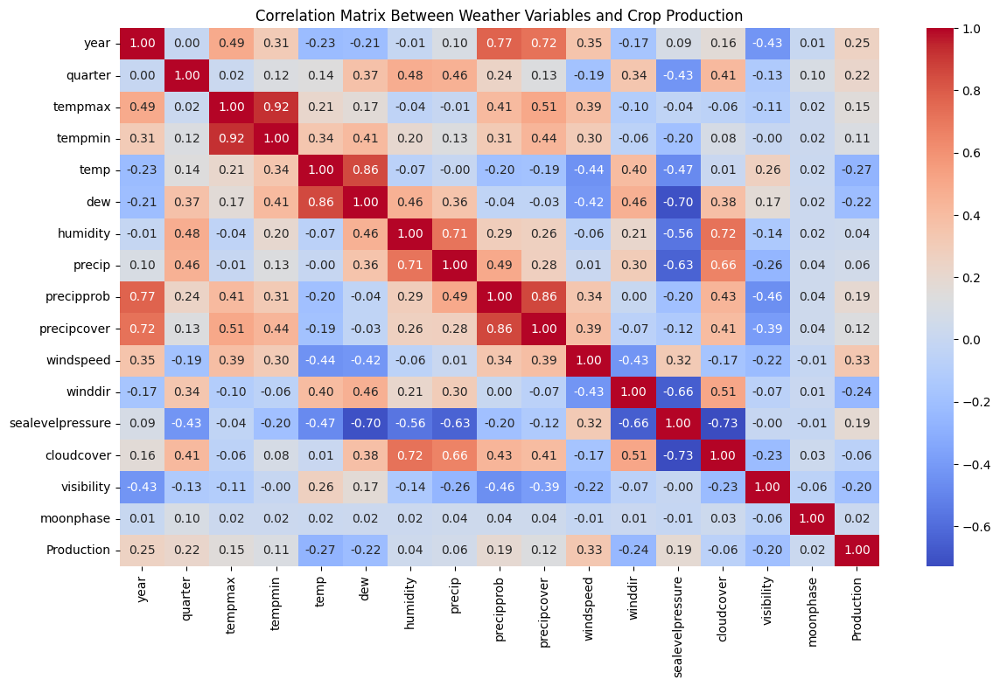

In [30]:
import seaborn as sns
# Calculate the correlation matrix
correlation_matrix = df_joined.corr()

# Plot the correlation matrix as a heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix Between Weather Variables and Crop Production')
plt.show()

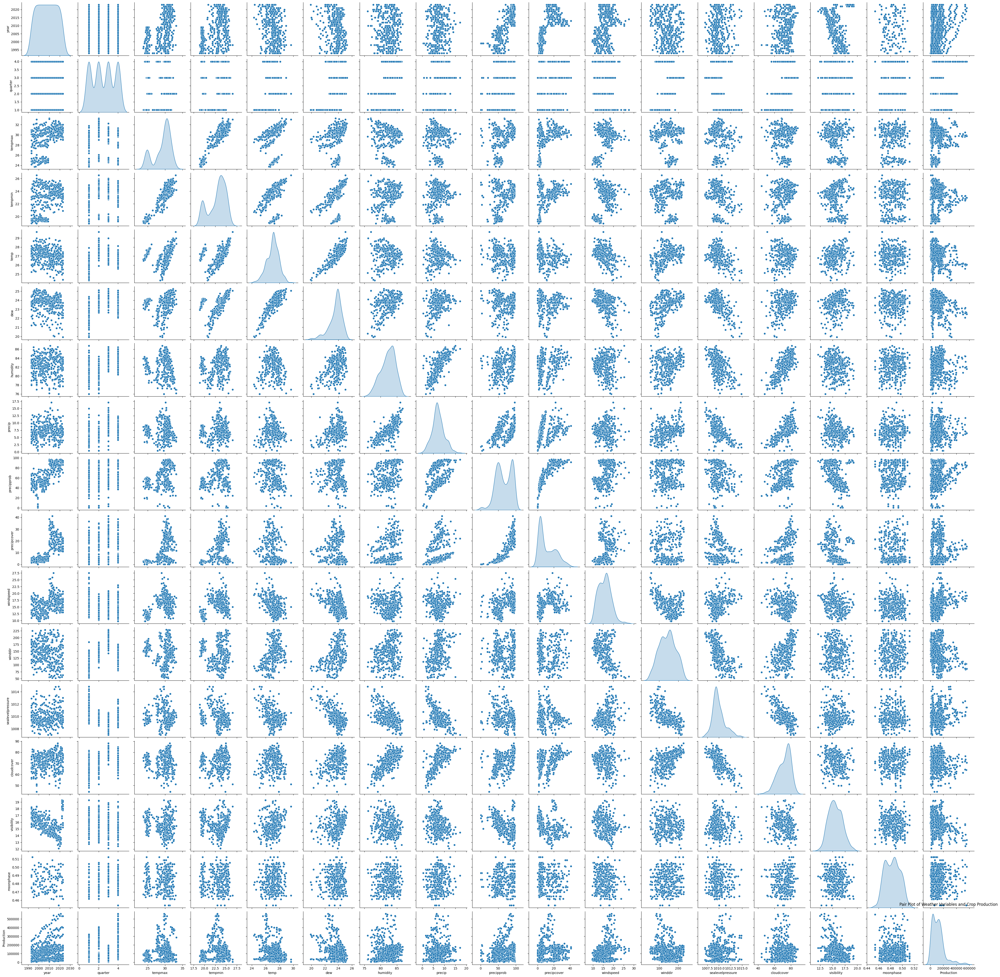

In [31]:
# Pair plot to visualize pairwise relationships
sns.pairplot(df_joined, diag_kind='kde')
plt.title('Pair Plot of Weather Variables and Crop Production')
plt.show()

In [32]:
df_joined.dropna(subset=['region'], inplace=True)
df_joined.dropna(subset=['Crop'], inplace=True)
df_joined

,region,year,quarter,Crop,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase,Production
0,Luzon,1993.0,1.0,Irrigated Palay,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667,127372.428571
1,Luzon,1993.0,1.0,Rainfed Palay,26.857146,20.186651,25.253071,21.214921,79.089679,3.044906,35.480807,2.103840,18.964321,117.908482,1012.908172,56.817508,16.572012,0.475667,19822.714286
2,Luzon,1993.0,2.0,Irrigated Palay,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352,158464.428571
3,Luzon,1993.0,2.0,Rainfed Palay,30.592456,23.063673,28.119009,23.779991,78.163429,4.305849,39.682829,2.179451,18.237135,138.849802,1009.919518,56.124340,17.227798,0.488352,5055.428571
4,Luzon,1993.0,3.0,Irrigated Palay,28.913673,22.711307,26.979919,23.873858,83.763352,9.810591,67.325800,5.197096,15.879650,187.879503,1008.458675,76.066747,15.815292,0.490326,34435.571429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
739,Visayas,2023.0,2.0,Rainfed Palay,31.478022,24.491690,27.437431,23.384959,79.394712,5.953988,90.521978,20.086724,15.808379,144.123146,1009.385920,71.172665,19.228984,0.461868,44387.963333
740,Visayas,2023.0,3.0,Irrigated Palay,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891,163574.943333
741,Visayas,2023.0,3.0,Rainfed Palay,31.328533,24.546535,27.325000,23.713587,81.383696,6.868519,92.051630,22.313886,17.785802,207.267595,1009.072147,77.310937,18.633220,0.484891,142341.023333
742,Visayas,2023.0,4.0,Irrigated Palay,30.801902,24.278668,27.003668,23.695041,82.763451,6.895497,94.089674,18.124586,16.838927,85.877717,1010.938519,63.951495,19.031182,0.503152,195913.763333


## ML Pipeline

### Hyperparameter Tuning

In [33]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error

def plot_df(df):
    df.plot(subplots=True, figsize=(13, 2*df.shape[1]))
    plt.show()

random_state = 143

import warnings
def warn(*args, **kwargs):
    pass
warnings.warn = warn
warnings.filterwarnings('ignore')

models = {
    'Support Vector Regression': SVR(kernel='linear'),
    'K-Nearest Neighbors': KNeighborsRegressor(),
    'Decision Tree': DecisionTreeRegressor(random_state=random_state),
    'Random Forest': RandomForestRegressor(random_state=random_state),
    'Gradient Boosting': GradientBoostingRegressor(random_state=random_state),
    'AdaBoost': AdaBoostRegressor(random_state=random_state),
    'XGBoost': XGBRegressor(random_state=random_state)
}

def optimize_model(name, x_train, y_train, x_val, y_val):
    params_dict = {
        'AdaBoost': {
            'n_estimators': [20, 30, 40, 50, 60, 70, 80, 90, 100],
            'learning_rate': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
            'loss': ['linear', 'square', 'exponential']
        },
        'Support Vector Regression': {
            'degree': [1, 2, 3, 4, 5],
            'gamma': ['scale', 'auto'],
            'C': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
        },
        'K-Nearest Neighbors': {
            'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
            'weights': ['uniform', 'distance'],
            'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
            'leaf_size': [10, 20, 30, 40, 50, 60],
        },
        'Decision Tree': {
            'criterion': ['squared_error', 'friedman_mse', 'absolute_error', 'poisson'],
            'splitter': ['best', 'random'],
            'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
            'max_features': ['sqrt', 'log2']
        },
        'Random Forest': {
            'n_estimators': [30, 40, 50, 60, 70, 80, 90, 100],
            'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10]
        },
        'Gradient Boosting': {
            'learning_rate': [0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
            'n_estimators': [30, 40, 50, 60, 70, 80, 90, 100],
            'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10]
        },
        'XGBoost': {
            'reg_lambda': [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
            'alpha': [0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0],
            'max_depth': [2, 5, 10, 20],
            'booster': ['gbtree', 'gblinear', 'dart']
        }
    }

    parameters = params_dict[name]
    model = models[name]
    model.fit(x_train, y_train.ravel())
    scorer = make_scorer(mean_absolute_error)
    grid = GridSearchCV(estimator=model, param_grid=parameters, cv=5, n_jobs=10, scoring=scorer, verbose=0)
    grid.fit(x_train, y_train.ravel())
    best_params = grid.best_params_
    try:
        best_model = model.set_params(**best_params, random_state=random_state)
    except:
        best_model = model.set_params(**best_params)
    y_pred = best_model.predict(x_val)
    test_mae = mean_absolute_error(y_val, y_pred)
    return best_params, test_mae

In [34]:
# Train-Val-Test dates
train_end  = (2020, 4)
val_start  = (2021, 1)
val_end    = (2022, 4)
test_start = (2023, 1)
test_end = (2023, 4)
pred_start = (2024, 1)

In [35]:
def get_best_model(df):
    # Train-Val split
    df_train = df[:train_end]
    df_val   = df[val_start:val_end]

    x_train  = df_train.drop(['Production'], axis=1).to_numpy()
    y_train  = df_train[['Production']].to_numpy()

    x_val    = df_val.drop(['Production'], axis=1).to_numpy()
    y_val    = df_val[['Production']].to_numpy()

    # Z-score normalization
    scaler_x = StandardScaler().fit(x_train)
    scaler_y = StandardScaler().fit(y_train)

    x_train = scaler_x.transform(x_train)
    y_train = scaler_y.transform(y_train)
    x_val   = scaler_x.transform(x_val)
    y_val   = scaler_y.transform(y_val)

    best_params_dict = {}
    test_mae_dct = {}
    for mname in models.keys():
        best_params, test_mae = optimize_model(mname, x_train, y_train, x_val, y_val)
        best_params_dict[mname] = best_params
        test_mae_dct[mname] = test_mae

    sorted_test_mae_dct = dict(sorted(test_mae_dct.items(), key=lambda x: x[1]))
    best_model = list(sorted_test_mae_dct.keys())[0]
    return best_model, best_params_dict[best_model]

try:
    df_best_loaded = pd.read_csv('best_models_and_params_LVM.csv')
except:
    df_best_loaded = None

rows = []
best_models = {}
for i in pd.unique(df_joined['region']):
    for j in pd.unique(df_joined['Crop']):
        if i not in best_models.keys():
            best_models[i] = {}
        if (df_best_loaded is not None
            and i in df_best_loaded['region'].tolist()
            and j in df_best_loaded['crop'].tolist()
        ):
            print(f"Loading best model and best params for {i} / {j}")

            best_params = df_best_loaded[
                (df_best_loaded.region == i) & (df_best_loaded.crop == j)].head(1)['best_params'].iloc[0]

            best_params = json.loads(best_params.replace("'", "\""))

            best_model = df_best_loaded[
                (df_best_loaded.region == i) & (df_best_loaded.crop == j)].head(1)['best_model'].iloc[0]

            model = models[best_model]
            model = model.set_params(**best_params)
            
            row = {
                'crop': j,
                'region': i,
                'best_model': best_model,
                'best_params': best_params
            }
        else:
            print(f"Finding best model for {i} / {j}")
            df = df_joined[df_joined.region==i]
            df = df[df.Crop == j]
            df.set_index(['year', 'quarter'], inplace=True)
            df.drop(['region', 'Crop'], inplace=True, axis=1)
            best_model, best_params = get_best_model(df)
            model = models[best_model]
            model = model.set_params(**best_params)
            
            row = {
                'crop': j,
                'region': i,
                'best_model': best_model,
                'best_params': best_params
            }
        rows.append(row)
        best_models[i][j] = model

df_best = pd.DataFrame(rows)
df_best.to_csv('best_models_and_params_LVM.csv')

Finding best model for Luzon / Irrigated Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [10:59:44] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [10:59:44] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [10:59:44] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [10:59:44] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

Finding best model for Luzon / Rainfed Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:17] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:17] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:17] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:17] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

Finding best model for Mindanao / Irrigated Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:00:51] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

Finding best model for Mindanao / Rainfed Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:01:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:01:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:01:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:01:25] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

Finding best model for Visayas / Irrigated Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:00] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

Finding best model for Visayas / Rainfed Palay


/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(smsg, UserWarning)
/Users/norwinvizcarra/Library/Python/3.9/lib/python/site-packages/xgboost/core.py:160: UserWarning: [11:02:35] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:742: 
Parameters: { "max_depth" } are not used.

  warnings.warn(sms

### Run model on test

Test MAE = 33810.39017857145 - Best model
Test RMSE = 41867.8902910361 - Best model
Test MAPE = 0.13297851698927818 - Best model
Naive MAE = 10606.933928571438 - Best model
Naive RMSE = 12317.646474296605 - Best model
Naive MAPE = 0.03821346761353742 - Best model


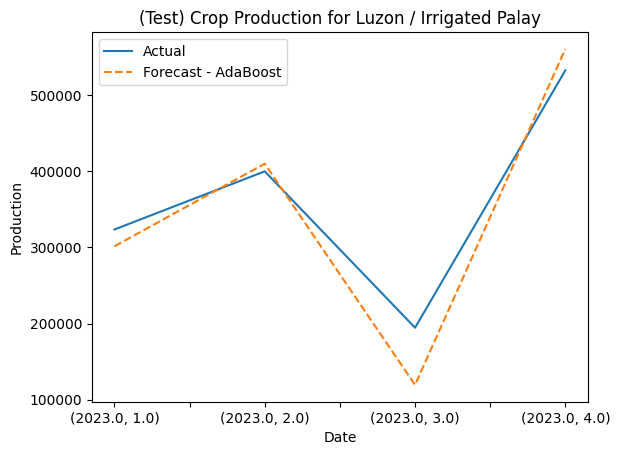

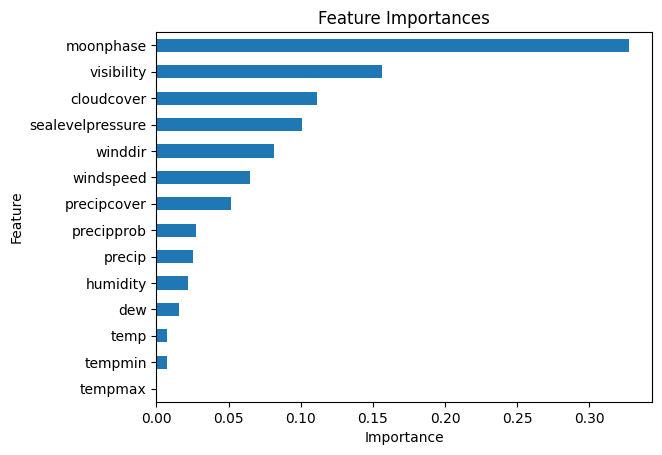

Test MAE = 6612.852464285705 - Best model
Test RMSE = 8141.106103593102 - Best model
Test MAPE = 0.12601601566492426 - Best model
Naive MAE = 3284.877857142864 - Best model
Naive RMSE = 4327.321861289491 - Best model
Naive MAPE = 0.055064941707522366 - Best model


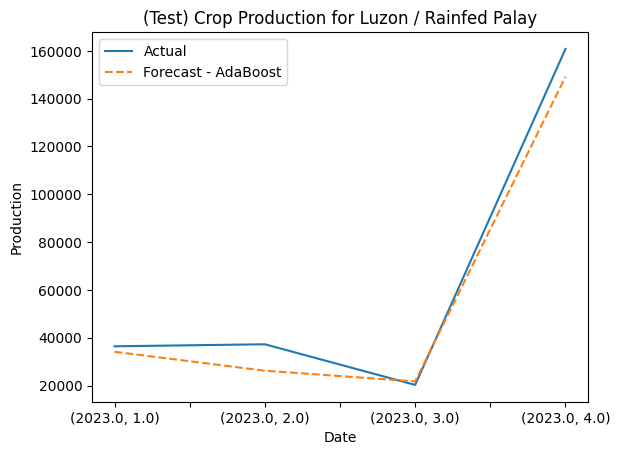

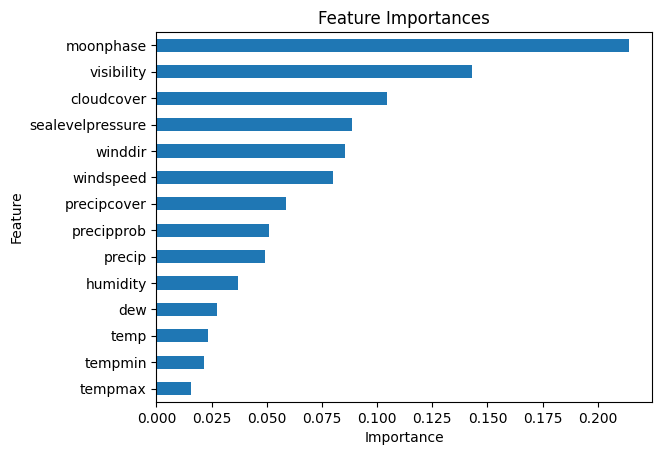

Test MAE = 21472.41253262574 - Best model
Test RMSE = 25874.34683352856 - Best model
Test MAPE = 0.15423051180289835 - Best model
Naive MAE = 6477.500416666666 - Best model
Naive RMSE = 7649.020821291304 - Best model
Naive MAPE = 0.051822154635764006 - Best model


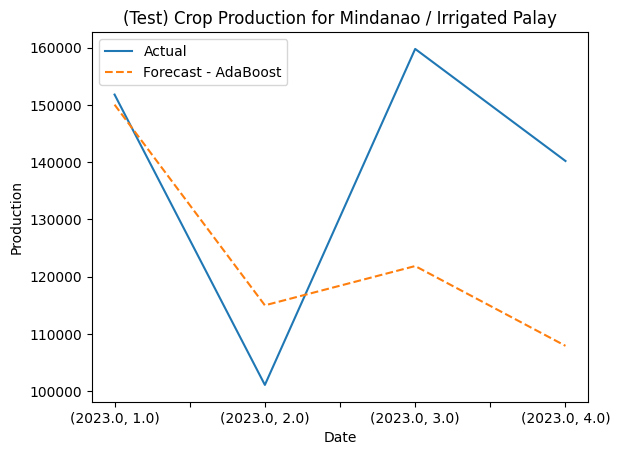

Test MAE = 10449.41305555556 - Best model
Test RMSE = 12801.862651051184 - Best model
Test MAPE = 0.21847132346287662 - Best model
Naive MAE = 3945.505416666665 - Best model
Naive RMSE = 4144.223277201736 - Best model
Naive MAPE = 0.0688571229700488 - Best model


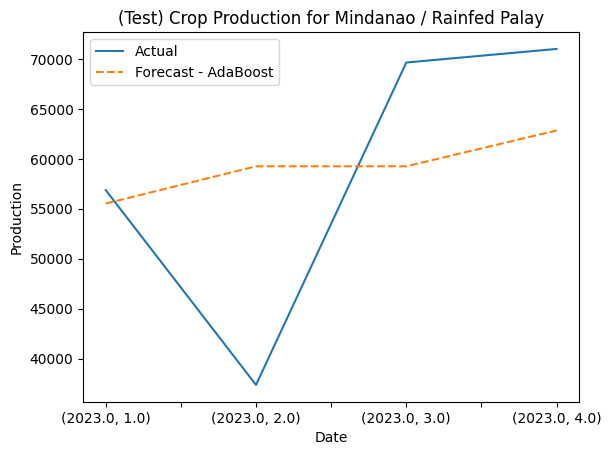

Test MAE = 34154.894109939385 - Best model
Test RMSE = 42432.36453576215 - Best model
Test MAPE = 0.3302489179719236 - Best model
Naive MAE = 10999.699166666665 - Best model
Naive RMSE = 11585.82996532702 - Best model
Naive MAPE = 0.07461633397603241 - Best model


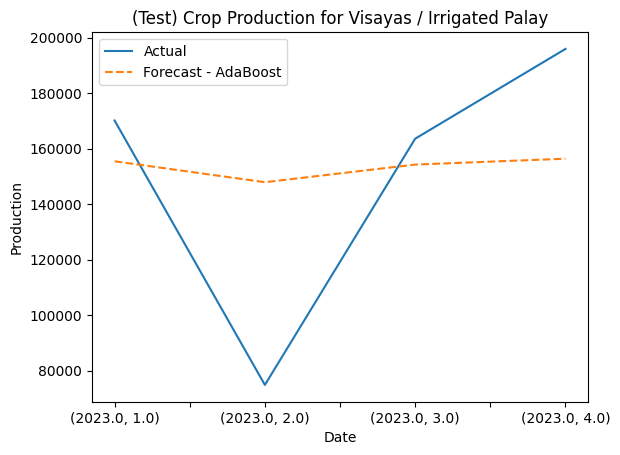

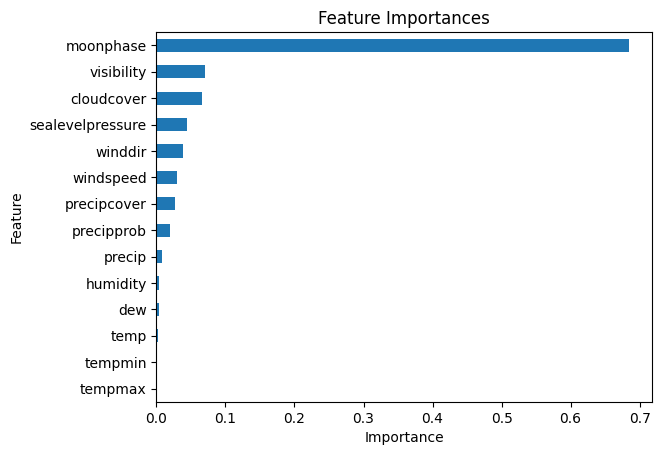

Test MAE = 21341.601623015868 - Best model
Test RMSE = 28057.92636976941 - Best model
Test MAPE = 0.13462522066019547 - Best model
Naive MAE = 8782.79083333334 - Best model
Naive RMSE = 13084.037789457765 - Best model
Naive MAPE = 0.07945972919656628 - Best model


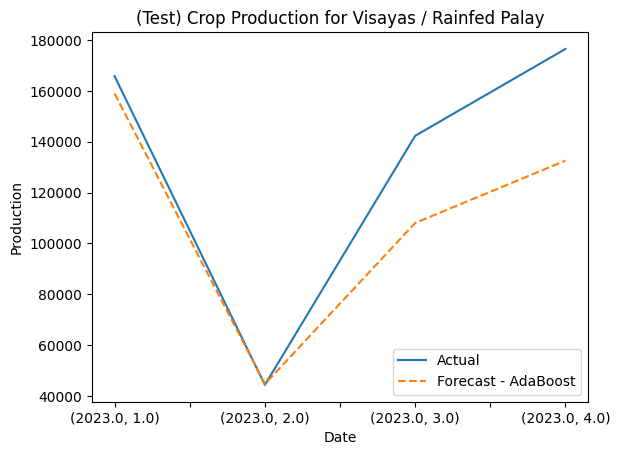

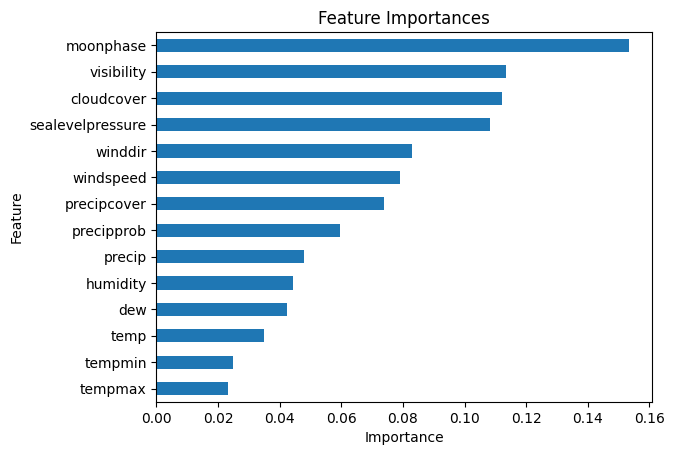

In [36]:
from sklearn.metrics import root_mean_squared_error
from sklearn.metrics import mean_absolute_percentage_error

def run_test(df, model):
    # Train-Test split
    df_train = df[:val_end]
    df_test  = df[test_start:]

    x_train  = df_train.drop(['Production'], axis=1).to_numpy()
    y_train  = df_train[['Production']].to_numpy()

    x_test   = df_test.drop(['Production'], axis=1).to_numpy()
    y_test   = df_test[['Production']].to_numpy()

    # Z-score normalization
    scaler_x = StandardScaler().fit(x_train)
    scaler_y = StandardScaler().fit(y_train)

    x_train  = scaler_x.transform(x_train)
    y_train  = scaler_y.transform(y_train)
    x_test   = scaler_x.transform(x_test)
    y_test   = scaler_y.transform(y_test)

    model.fit(x_train, y_train.ravel())

    # Evaluate
    y_pred  = model.predict(x_test)
    y_pred  = scaler_y.inverse_transform(y_pred[..., np.newaxis])
    y_true  = scaler_y.inverse_transform(y_test)

    y_pred_naive = df[:val_end].tail(4)['Production'].values


    test_mae = mean_absolute_error(y_true, y_pred)
    print(f'Test MAE = {test_mae} - Best model')

    test_rmse = root_mean_squared_error(y_true, y_pred)
    print(f'Test RMSE = {test_rmse} - Best model')

    test_mape = mean_absolute_percentage_error(y_true, y_pred)
    print(f'Test MAPE = {test_mape} - Best model')

    naive_mae = mean_absolute_error(y_true, y_pred_naive)
    print(f'Naive MAE = {naive_mae} - Best model')

    naive_rmse = root_mean_squared_error(y_true, y_pred_naive)
    print(f'Naive RMSE = {naive_rmse} - Best model')

    naive_mape = mean_absolute_percentage_error(y_true, y_pred_naive)
    print(f'Naive MAPE = {naive_mape} - Best model')

    df_test['Production'].plot(title=f'Quarterly {croptype} Production', xlabel='Date', ylabel='Production')
    plt.plot(y_pred, linestyle='--')
    plt.legend(['Actual', f'Forecast - {best_model}'])
    plt.autoscale()
    plt.title(f"(Test) Crop Production for {region} / {croptype}")
    plt.show()



    try:
        plt.figure()
        feat_importances = pd.Series(
            sorted(
                model.feature_importances_
            ),
                index=df_train.drop(['Production'], axis=1).columns
        )
        feat_importances.plot(kind='barh')
        plt.title("Feature Importances")
        plt.xlabel("Importance")
        plt.ylabel("Feature")
        plt.show()
    except:
        pass
    return test_mae


test_mae_dct = {}
for region in best_models:
    for croptype in best_models[region]:
        df = df_joined[df_joined.region==region]
        df = df[df.Crop == croptype]
        df.set_index(['year', 'quarter'], inplace=True)
        df.drop(['region', 'Crop'], inplace=True, axis=1)
        test_mae = run_test(df, best_models[region][croptype])

        if region not in test_mae_dct.keys():
            test_mae_dct[region] = {}

        test_mae_dct[region][croptype] = {
            'test_mae': test_mae,
            'model': type(best_models[region][croptype]).__name__
        }

with open('test_results.json', 'w') as f:
    json.dump(test_mae_dct, f, indent=4)

### Predict Q1 2024

In [37]:
def run_prediction(df, df_pred, model, region, croptype):
    df_train = df[:test_end]
    df_2024  = df_pred[pred_start:]

    x_train  = df_train.drop(['Production'], axis=1).to_numpy()
    y_train  = df_train[['Production']].to_numpy()

    x_2024   = df_2024.drop(['Production'], axis=1).to_numpy()
    y_2024   = df_2024[['Production']].to_numpy()

    # Z-score normalization
    scaler_x = StandardScaler().fit(x_train)
    scaler_y = StandardScaler().fit(y_train)

    x_train  = scaler_x.transform(x_train)
    y_train  = scaler_y.transform(y_train)
    x_2024   = scaler_x.transform(x_2024)
    y_2024   = scaler_y.transform(y_2024)

    # Fit model
    model.fit(x_train, y_train.ravel())

    # Evaluate
    y_pred  = model.predict(x_2024)
    y_pred  = scaler_y.inverse_transform(y_pred[..., np.newaxis])

    lime_explainer = LimeTabularExplainer(
        x_train,
        feature_names=df_train.columns,
        mode='regression',
    )

    lime_exp = lime_explainer.explain_instance(
        x_2024[0],
        model.predict
    )

    print(f"Explaining {region} / {croptype} 2024 Q1 prediction where predicted value is {y_pred[0][0]}")
    lime_exp.show_in_notebook(show_all=True)
    print("\n")

    return y_pred[0][0]

In [38]:
rows = []

try:
    df_pred.set_index(['year', 'quarter'], inplace=True)
except:
    pass

for region in best_models:
    for croptype in best_models[region]:
        df = df_joined[(df_joined.region==region)]
        df = df[(df.Crop == croptype)]
        df.set_index(['year', 'quarter'], inplace=True)
        df_pred_2 = df_pred[df_pred.region==region]
        
        df.drop(['region', 'Crop'], inplace=True, axis=1)
        df_pred_2.drop(['region', 'Crop'], inplace=True, axis=1)
        predicted = run_prediction(df, df_pred_2, best_models[region][croptype], region, croptype)
        if predicted < 0:
            predicted = 0
        row = {
            'region': region,
            'crop': croptype,
            'predicted': predicted
        }
        rows.append(row)

df_2024_prediction = pd.DataFrame(rows)
df_2024_prediction.to_csv("2024_predictions.csv")
display(df_2024_prediction)

Explaining Luzon / Irrigated Palay 2024 Q1 prediction where predicted value is 310095.5571428571




Explaining Luzon / Rainfed Palay 2024 Q1 prediction where predicted value is 34294.89150183152




Explaining Mindanao / Irrigated Palay 2024 Q1 prediction where predicted value is 117748.83716505917




Explaining Mindanao / Rainfed Palay 2024 Q1 prediction where predicted value is 41710.45722222222




Explaining Visayas / Irrigated Palay 2024 Q1 prediction where predicted value is 139456.33987084098




Explaining Visayas / Rainfed Palay 2024 Q1 prediction where predicted value is 128952.75833333333


,region,crop,predicted
0,Luzon,Irrigated Palay,310095.557143
1,Luzon,Rainfed Palay,34294.891502
2,Mindanao,Irrigated Palay,117748.837165
3,Mindanao,Rainfed Palay,41710.457222
4,Visayas,Irrigated Palay,139456.339871
5,Visayas,Rainfed Palay,128952.758333


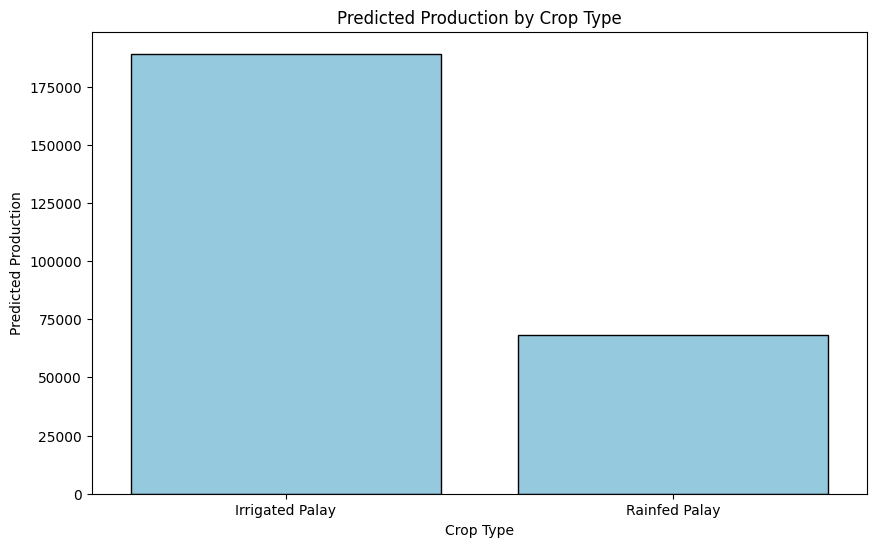

In [39]:
crop_grouped1 = df_2024_prediction.groupby('crop')['predicted'].mean().reset_index()
plt.figure(figsize=(10, 6))
sns.barplot(x='crop', y='predicted', data=crop_grouped1, color='skyblue', edgecolor='black')
plt.title('Predicted Production by Crop Type')
plt.xlabel('Crop Type')
plt.ylabel('Predicted Production')
plt.show()

## Side by side comparison actual vs predicted

In [40]:
# Load the actual and predicted data
actual_file_path = '2024_Q1_actual.csv'
predicted_file_path = '2024_predictions.csv'

results_actual = pd.read_csv(actual_file_path)
results_predicted = pd.read_csv(predicted_file_path)

In [41]:
results_actual = results_actual[results_actual['crop'].isin(filtered_crops)]

In [42]:
results_actual['region'] = results_actual['region'].map(region_to_island)
results_actual = results_actual.groupby(['crop', 'region']).mean()
results_actual.reset_index(inplace=True)
results_actual

,crop,region,actual
0,Irrigated Palay,Luzon,318552.535714
1,Irrigated Palay,Mindanao,144571.191667
2,Irrigated Palay,Visayas,167160.123333
3,Rainfed Palay,Luzon,35603.142857
4,Rainfed Palay,Mindanao,56268.823333
5,Rainfed Palay,Visayas,166476.630000


In [43]:
# Merge the actual and predicted data on 'region' and 'crop'
results_merged = pd.merge(results_actual, results_predicted, on=['crop', 'region'], how='inner')

Error is 3.164676677188684 %


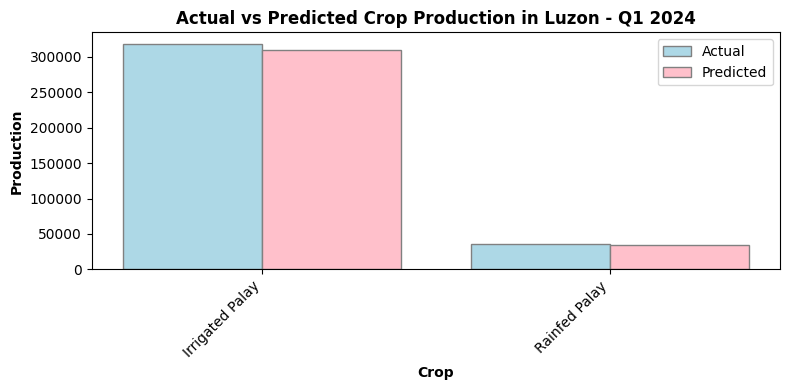

Error is 22.21296206897349 %


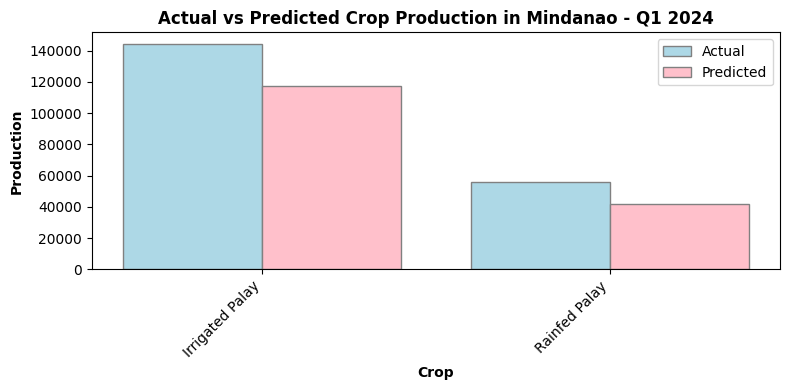

Error is 19.55661236182555 %


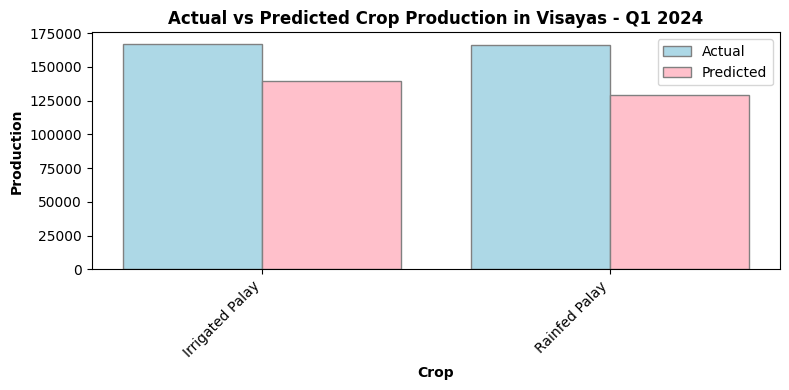

Mean error across regions is: 14.978083702662573 %


In [44]:
def get_error(actual, predicted):
    diffs = np.abs(actual - predicted)
    e = []
    for i in range(0, len(diffs)):
        temp = (diffs[i] / np.abs(actual[i])) * 100
        e.append(temp)

    return np.mean(e)

def plot_side_by_side_bars(region, df):
    df_region = df[df['region'] == region]
    
    # Create a side-by-side bar plot
    bar_width = 0.4
    fig, ax = plt.subplots(figsize=(8, 4))
    
    # Create positions for the bars
    r1 = range(len(df_region))
    r2 = [x + bar_width for x in r1]
    
    # Plot actual values
    ax.bar(r1, df_region['actual'], color='lightblue', width=bar_width, edgecolor='grey', label='Actual')
    
    # Plot predicted values
    ax.bar(r2, df_region['predicted'], color='pink', width=bar_width, edgecolor='grey', label='Predicted')
    
    # Add labels and title
    ax.set_xlabel('Crop', fontweight='bold')
    ax.set_ylabel('Production', fontweight='bold')
    ax.set_title(f'Actual vs Predicted Crop Production in {region} - Q1 2024', fontweight='bold')
    ax.set_xticks([r + bar_width/2 for r in range(len(df_region))])
    ax.set_xticklabels(df_region['crop'], rotation=45, ha='right')
    ax.legend()
    
    # compute error
    actual = np.array(df_region['actual'].tolist())
    predicted = np.array(df_region['predicted'].tolist())
    
    error = get_error(actual, predicted)

    print(f"Error is {error} %")

    # show plot
    plt.tight_layout()
    plt.show()

    return error

# Plot data for each region
unique_regions = results_merged['region'].unique()
errors = []
for region in unique_regions:
    errors.append(plot_side_by_side_bars(region, results_merged))
mean_error = np.mean(errors)
print(f"Mean error across regions is: {mean_error} %")

## Sensitivity Analysis

Play around with values to see how different weather conditions affect crop production with the help of LIME to understand which features push the values up/down

In [45]:
region = 'Luzon'
croptype = 'Irrigated Palay'

config = {
    'region': region,
    'Crop': croptype,
    'tempmax': 27.955311,
    #'tempmin': 17.165201,
    'tempmin': 12.165201,
    #'temp': 21.999817,
    'temp': 19.999817,
    'dew': 17.956777,
    'humidity': 79.819963,
    #'precip': 1.512938,
    'precip': 20.512938,
    'precipprob': 66.666667,
    'precipcover': 17.231575,
    'windspeed': 13.777656,
    'winddir': 122.811172,
    'sealevelpressure': 1016.071795,
    'cloudcover': 51.001832,
    'visbility': 16.290476,
    'moonphase': 0.488901,
    'Production': None,
    'year': 2024,
    'quarter': 1
}

df_pred_sensitivity = pd.DataFrame([config], columns=list(config.keys()))
df_pred_sensitivity.set_index(['year', 'quarter'], inplace=True)

df = df_joined[(df_joined.region==region)]
df = df[(df.Crop == croptype)]
df.set_index(['year', 'quarter'], inplace=True)

df_pred_2 = df_pred[df_pred.region==region]
df_pred_2.drop(['region', 'Crop'], inplace=True, axis=1)
df.drop(['region', 'Crop'], inplace=True, axis=1)
df_pred_sensitivity.drop(['region', 'Crop'], inplace=True, axis=1)

display(df_pred_2)
predicted = run_prediction(df, df_pred_2, best_models[region][croptype], region, croptype)
print(f"Predicted value with original values: {predicted}")
print("\n")

display(df_pred_sensitivity)
predicted_changed = run_prediction(df, df_pred_sensitivity, best_models[region][croptype], region, croptype)
print(f"Predicted value with changed values: {predicted_changed}")

change = (np.abs(predicted - predicted_changed) / predicted) * 100
print(f"\n% change between actual predicted and sensitivity predicted: {change} %")


,,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visibility,moonphase,Production
year,quarter,,,,,,,,,,,,,,,
2024.0,1.0,30.064751,21.111975,25.038856,20.261454,76.364497,1.907995,66.63849,9.929155,19.230149,91.879825,1014.867822,53.163511,16.226148,0.488901,NaN


Explaining Luzon / Irrigated Palay 2024 Q1 prediction where predicted value is 310095.5571428571




Predicted value with original values: 310095.5571428571




,,tempmax,tempmin,temp,dew,humidity,precip,precipprob,precipcover,windspeed,winddir,sealevelpressure,cloudcover,visbility,moonphase,Production
year,quarter,,,,,,,,,,,,,,,
2024,1,27.955311,12.165201,19.999817,17.956777,79.819963,20.512938,66.666667,17.231575,13.777656,122.811172,1016.071795,51.001832,16.290476,0.488901,None


Explaining Luzon / Irrigated Palay 2024 Q1 prediction where predicted value is 310095.5571428571




Predicted value with changed values: 310095.5571428571

% change between actual predicted and sensitivity predicted: 0.0 %
